In [2]:
import pandas as pd
import numpy as np
import plotly.express as px
import time
import umap
import matplotlib.pyplot as plt
from matplotlib import pyplot
import plotly.graph_objs as go

# data 

In [3]:
def prepare_data(df, date_columns=None, fill=-1, verbose=False):
    
    # copy to not mofidy original df
    df = df.copy()
    all_values = len(df)
    
    # parse dates
    date_columns = date_columns if date_columns else []
    for c in date_columns:
        df[c] = df[c].apply(pd.to_datetime)
        df[f'{c}_year'] = df[c].apply(lambda x: x.year if x else None)
        df[f'{c}_month'] = df[c].apply(lambda x: x.month if x else None)
        df[f'{c}_day'] = df[c].apply(lambda x: x.day if x else None)
        df[f'{c}_weekday'] = df[c].apply(lambda x: x.weekday() if x else None)
    df.drop(columns=date_columns, inplace=True)
    
    # infer dtypes
    df = df.infer_objects().convert_dtypes()
    
    # find string columns
    string_columns = [c for t, c in zip(df.dtypes, df.columns) if str(t) == 'string']
    
    # analyze string columns
    col_to_drop = []
    col_to_hot = []
    for c in string_columns:
        unique_values = df[c].nunique()
        unique_pct = unique_values / (all_values / 100)
        if unique_pct > 30 or unique_values == 1:
            col_to_drop.append(c)
        else:
            col_to_hot.append(c)
            
    # drop
    df.drop(columns=col_to_drop, inplace=True)
    
    # hot encoding
    for c in col_to_hot:
        dm_df = pd.get_dummies(df[c])
        dm_df.columns = [f'{c}_{dc}' for dc in dm_df.columns]
        df = df.join(dm_df)
        df.drop(columns=col_to_hot, inplace=True)
    
    # na check
    for c in df.columns:
        na_count = df[c].isna().sum()
        if na_count == all_values:
            df.drop(columns=[c], inplace=True)
            continue
        else:
            if str(df[c].dtype) == 'boolean':
                df[c] = df[c].fillna(False)
            else:
                df[c] = df[c].fillna(fill)
    return df
        

In [49]:
df = pd.read_csv('./machine_temperature_system_failure.csv')

In [50]:
df = df.sample(frac=0.25, replace=True, random_state=1).sort_values(by='timestamp').reset_index(drop=True)

In [51]:
df

,timestamp,value
0,2013-12-02 22:00:00,79.486523
1,2013-12-02 22:25:00,80.377789
2,2013-12-02 22:30:00,80.479237
3,2013-12-02 22:30:00,80.479237
4,2013-12-02 22:45:00,81.690942
...,...,...
5669,2014-02-19 13:30:00,94.806127
5670,2014-02-19 14:00:00,95.108901
5671,2014-02-19 14:20:00,95.961107
5672,2014-02-19 14:45:00,97.284578


<AxesSubplot:xlabel='timestamp'>

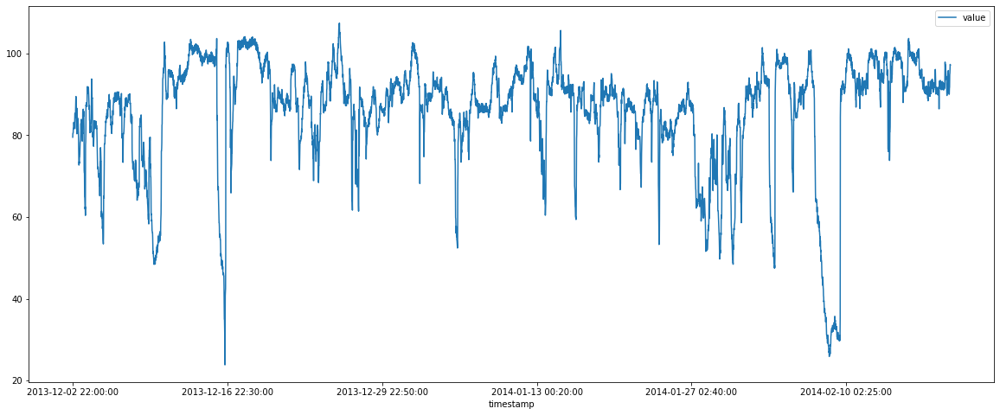

In [52]:
df.plot.line(x='timestamp', y='value', figsize=(20,8))

In [53]:
df_prepared = prepare_data(df, date_columns=['timestamp'])

In [54]:
df_prepared

,value,timestamp_year,timestamp_month,timestamp_day,timestamp_weekday
0,79.486523,2013,12,2,0
1,80.377789,2013,12,2,0
2,80.479237,2013,12,2,0
3,80.479237,2013,12,2,0
4,81.690942,2013,12,2,0
...,...,...,...,...,...
5669,94.806127,2014,2,19,2
5670,95.108901,2014,2,19,2
5671,95.961107,2014,2,19,2
5672,97.284578,2014,2,19,2


# reducer (if needed)

In [55]:
reducer = umap.UMAP(n_components=2)

In [56]:
embedding = reducer.fit_transform(df_prepared)

In [57]:
embedding = pd.DataFrame(embedding, columns=['x', 'y'])

In [58]:
embedding

,x,y
0,-0.748673,-4.575637
1,-0.835530,-4.645849
2,-0.849297,-4.643514
3,-0.856575,-4.657615
4,-1.026364,-4.843074
...,...,...
5669,10.338657,24.076511
5670,10.344952,24.078329
5671,10.331576,24.096615
5672,10.378374,24.081615


In [59]:
fig = px.scatter(x=embedding['x'], y=embedding['y'])
fig.show()

# visualizations 

In [23]:
def plot_anomaly(df, title='anomalies', value_name='over'):
    dates = df['over']
    bool_array = df['anomaly'].apply(lambda x: x == 1)
    actuals = df['value'][-len(bool_array):]
    anomaly_points = bool_array * actuals
    anomaly_points[anomaly_points == 0] = np.nan
    
    actuals = go.Scatter(
        name=value_name,
        x=dates,
        y=df['value'],
        xaxis='x1', yaxis='y1',
        mode='lines',
        marker=dict(size=12,
                   line=dict(width=1),
                   color='blue'
                   )
    )
    
    anomalies_map = go.Scatter(name="anomaly",
                               showlegend=True,
                               x=dates,
                               y=anomaly_points,
                               mode='markers',
                               xaxis='x1',
                               yaxis='y1',
                               marker=dict(color="red",
                                           size=11,
                                           line=dict(
                                               color="red",
                                               width=2)))
    axis = dict(
            showline=True,
            zeroline=False,
            showgrid=True,
            mirror=True,
            ticklen=4,
            gridcolor='#ffffff',
            tickfont=dict(size=10))

    layout = dict(
            width=900,
            height=500,
            title=title,
            showlegend=True
    )
    
    fig = go.Figure(data=[anomalies_map, actuals], layout=layout)

    pyplot.show()
    return fig
    
    
    

In [28]:
def pot_anomaly_umap(df, title='anomaly', anomaly_column='anomaly'):
    df = df.copy()
    df = df.sort_values(by=['anomaly'])
    df[anomaly_column] = df[anomaly_column].apply(lambda x: x == 1)

    fig = px.scatter(data_frame=df, x='x', y='y', color=anomaly_column,
                    color_discrete_sequence=['blue', 'red'],
                    width=600, height=600)
    return fig

# pyod

In [24]:
from pyod.models.abod import ABOD
from pyod.models.alad import ALAD
from pyod.models.anogan import AnoGAN
from pyod.models.auto_encoder import AutoEncoder
from pyod.models.auto_encoder_torch import AutoEncoder as AutoEncoderTorch
from pyod.models.cblof import CBLOF
from pyod.models.cd import CD
from pyod.models.cof import COF
from pyod.models.copod import COPOD
from pyod.models.deep_svdd import DeepSVDD
from pyod.models.ecod import ECOD
from pyod.models.feature_bagging import FeatureBagging
from pyod.models.gmm import GMM
from pyod.models.hbos import HBOS
from pyod.models.iforest import IForest
from pyod.models.inne import INNE
from pyod.models.kde import KDE
from pyod.models.knn import KNN
from pyod.models.kpca import KPCA
from pyod.models.lmdd import LMDD
from pyod.models.loci import LOCI
from pyod.models.loda import LODA
from pyod.models.lof import LOF
from pyod.models.lscp import LSCP
from pyod.models.lunar import LUNAR
from pyod.models.mad import MAD
from pyod.models.mcd import MCD
from pyod.models.mo_gaal import MO_GAAL
from pyod.models.ocsvm import OCSVM
from pyod.models.pca import PCA
from pyod.models.rgraph import RGraph
from pyod.models.rod import ROD
from pyod.models.sampling import Sampling
from pyod.models.so_gaal import SO_GAAL
from pyod.models.sod import SOD
from pyod.models.sos import SOS
from pyod.models.suod import SUOD
from pyod.models.vae import VAE
from pyod.models.xgbod import XGBOD

In [25]:
def auto_encoder_layers_generator(dataset, layers=4):
    max_n = len(dataset.columns)
    return [max_n] + [round(max_n/ 2) for _ in range(layers)] + [max_n]

In [69]:
models = [{
    'name': 'ABOD',
    'model': ABOD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'ALAD',
    'model': ALAD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': lambda x: x.plot_learning_curves(),
    'features': None
    },
# too long fit
# {
#     'name': 'AnoGAN',
#     'model': AnoGAN,
#     'score': lambda x: x.fit_predict_score(),
#     'confidence': lambda x: x.predict_confidence(),
#     'learning': lambda x: x.plot_learning_curves(),
#     'features': None
    
#     },
{
    'name': 'AutoEncoder',
    'model': lambda: AutoEncoder(hidden_neurons=auto_encoder_layers_generator(df_prepared)),
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'CBLOF',
    'model': CBLOF,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'COF',
    'model': COF,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'DeepSVDD',
    'model': DeepSVDD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'FeatureBagging',
    'model': FeatureBagging,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'GMM',
    'model': GMM,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'HBOS',
    'model': HBOS,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'IForest',
    'model': IForest,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': lambda x: x.feature_importances_
    },
{
    'name': 'INNE',
    'model': INNE,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'KDE',
    'model': KDE,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'KNN',
    'model': KNN,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'KPCA',
    'model': KPCA,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
#     too long
# {
#     'name': 'LOCI',
#     'model': LOCI,
#     'score': lambda x: x.fit_predict_score(),
#     'confidence': lambda x: x.predict_confidence(),
#     'learning': None,
#     'features': None
#     },
{
    'name': 'LODA',
    'model': LODA,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'LOF',
    'model': LOF,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'LUNAR',
    'model': LUNAR,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'MCD',
    'model': MCD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
#     too long, but may pe param tuning...
# {
#     'name': 'MO_GAAL',
#     'model': MO_GAAL,
#     'score': lambda x: x.fit_predict_score(),
#     'confidence': lambda x: x.predict_confidence(),
#     'learning': None,
#     'features': None
#     },
{
    'name': 'OCSVM',
    'model': OCSVM,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'PCA',
    'model': PCA,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features':  lambda x: x.explained_variance_
    },
    
# too long
# {
#     'name': 'RGraph',
#     'model': RGraph,
#     'score': lambda x: x.fit_predict_score(),
#     'confidence': lambda x: x.predict_confidence(),
#     'learning': None,
#     'features': None
#     },
{
    'name': 'ROD',
    'model': ROD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'Sampling',
    'model': Sampling,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
# {
#     'name': 'SO_GAAL',
#     'model': SO_GAAL,
#     'score': lambda x: x.fit_predict_score(),
#     'confidence': lambda x: x.predict_confidence(),
#     'learning': None,
#     'features': None
#     },
{
    'name': 'SOD',
    'model': SOD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'SOS',
    'model': SOS,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'SUOD',
    'model': SUOD,
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
{
    'name': 'VAE',
    'model': lambda: VAE(encoder_neurons=auto_encoder_layers_generator(df_prepared)),
    'score': lambda x: x.fit_predict_score(),
    'confidence': lambda x: x.predict_confidence(),
    'learning': None,
    'features': None
    },
]

In [70]:
len(models)

26

# prepare to run pipeline 

In [60]:
data = df_prepared.values

In [61]:
plot_df = df.rename(columns={'timestamp': 'over', 'value': 'value'}).copy()

In [62]:
plot_df

,over,value
0,2013-12-02 22:00:00,79.486523
1,2013-12-02 22:25:00,80.377789
2,2013-12-02 22:30:00,80.479237
3,2013-12-02 22:30:00,80.479237
4,2013-12-02 22:45:00,81.690942
...,...,...
5669,2014-02-19 13:30:00,94.806127
5670,2014-02-19 14:00:00,95.108901
5671,2014-02-19 14:20:00,95.961107
5672,2014-02-19 14:45:00,97.284578


In [63]:
embedding

,x,y
0,-0.748673,-4.575637
1,-0.835530,-4.645849
2,-0.849297,-4.643514
3,-0.856575,-4.657615
4,-1.026364,-4.843074
...,...,...
5669,10.338657,24.076511
5670,10.344952,24.078329
5671,10.331576,24.096615
5672,10.378374,24.081615


In [64]:
data

array([[79.48652315, 2013, 12, 2, 0],
       [80.37778929, 2013, 12, 2, 0],
       [80.47923735, 2013, 12, 2, 0],
       ...,
       [95.96110704, 2014, 2, 19, 2],
       [97.28457801, 2014, 2, 19, 2],
       [97.13546835, 2014, 2, 19, 2]], dtype=object)

# main pipeline

ABOD
model fit: 1.1069939136505127
model predict: 0.8979992866516113


ALAD
model fit: 84.18085432052612
model predict: 0.022017955780029297


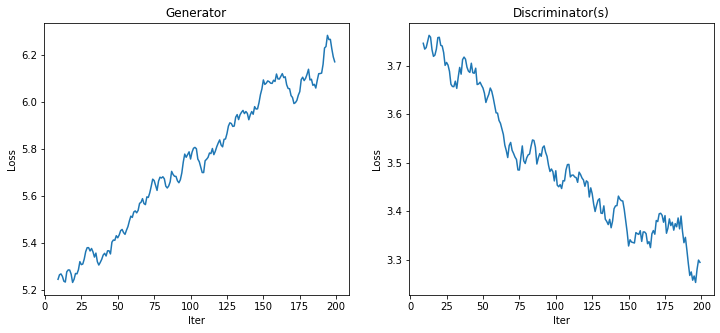

None


AutoEncoder
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_2175 (Dense)          (None, 5)                 30        
                                                                 
 dropout_154 (Dropout)       (None, 5)                 0         
                                                                 
 dense_2176 (Dense)          (None, 5)                 30        
                                                                 
 dropout_155 (Dropout)       (None, 5)                 0         
                                                                 
 dense_2177 (Dense)          (None, 5)                 30        
                                                                 
 dropout_156 (Dropout)       (None, 5)                 0         
                                                                 
 dense_2178 (Dense)          (None, 2)   

160/160 [==============================] - 0s 2ms/step - loss: 0.9970 - val_loss: 1.0494
Epoch 56/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9968 - val_loss: 1.0493
Epoch 57/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9968 - val_loss: 1.0492
Epoch 58/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9967 - val_loss: 1.0491
Epoch 59/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9966 - val_loss: 1.0490
Epoch 60/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9965 - val_loss: 1.0489
Epoch 61/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9964 - val_loss: 1.0488
Epoch 62/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9963 - val_loss: 1.0487
Epoch 63/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9962 - val_loss: 1.0487
Epoch 64/100
160/160 [==============================] - 0s 2ms/step - loss: 0.9961 - val_loss: 

CBLOF
model fit: 1.1429996490478516
model predict: 0.10949969291687012


COF
model fit: 7.109524250030518
model predict: 60.1744966506958


DeepSVDD
178/178 [==============================] - 0s 850us/step
Model: "model_2054"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_29 (InputLayer)       [(None, 5)]               0         
                                                                 
 dense_2185 (Dense)          (None, 64)                320       
                                                                 
 net_output (Dense)          (None, 32)                2048      
                                                                 
 tf.math.subtract_7 (TFOpLam  (None, 32)               0         
 bda)                                                            
                                                                 
 tf.math.pow_7 (TFOpLambda)  (None, 32)                0         
                                                                 
 tf.math.reduce_sum_7 (TFOpL  (None,)                  0

160/160 [==============================] - 0s 1ms/step - loss: 0.0994 - val_loss: 0.0994
Epoch 63/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0995 - val_loss: 0.0995
Epoch 64/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0993 - val_loss: 0.0991
Epoch 65/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0991 - val_loss: 0.0991
Epoch 66/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0991 - val_loss: 0.0993
Epoch 67/100
160/160 [==============================] - 0s 1ms/step - loss: 0.1001 - val_loss: 0.0995
Epoch 68/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0995 - val_loss: 0.0991
Epoch 69/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0991 - val_loss: 0.0991
Epoch 70/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0990 - val_loss: 0.0991
Epoch 71/100
160/160 [==============================] - 0s 1ms/step - loss: 0.0990 - val_loss: 

FeatureBagging
model fit: 0.4285011291503906
model predict: 0.34801602363586426


GMM
model fit: 0.07599592208862305
model predict: 0.0035009384155273438


HBOS
model fit: 0.00450444221496582
model predict: 0.001497030258178711


IForest
model fit: 0.536998987197876
model predict: 0.1940007209777832
[0.54704113 0.01503951 0.04355675 0.23182881 0.1625338 ]


INNE
model fit: 0.4924955368041992
model predict: 0.34252190589904785


KDE
model fit: 1.4780011177062988
model predict: 1.44350266456604


KNN
model fit: 0.031996965408325195
model predict: 0.5354986190795898


KPCA
model fit: 17.773500680923462
model predict: 2.8390235900878906


LODA
model fit: 0.08399319648742676
model predict: 0.04100298881530762


LOF
model fit: 0.044524431228637695
model predict: 0.03497767448425293


LUNAR
model fit: 3.3587255477905273
model predict: 0.03049635887145996


MCD
model fit: 2.2235195636749268
model predict: 0.0019807815551757812


OCSVM
model fit: 4.019021987915039
model predict: 1.9234790802001953


PCA
model fit: 0.0070035457611083984
model predict: 0.0035004615783691406
[2.07193657 1.06800004 0.9490089  0.90945104 0.00248481]


ROD
model fit: 3.3298773765563965
model predict: 0.4041564464569092


Sampling
model fit: 0.004000425338745117
model predict: 0.0024993419647216797


SOD
model fit: 20.367790699005127
model predict: 16.720000743865967


SOS
model fit: 20.84600043296814
model predict: 19.430502891540527


SUOD



[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    1.6s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    2.4s finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


model fit: 4.2930006980896

model predict: 0.7035238742828369


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.6s finished


VAE
Model: "model_2055"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_30 (InputLayer)          [(None, 5)]          0           []                               
                                                                                                  
 dense_2186 (Dense)             (None, 5)            30          ['input_30[0][0]']               
                                                                                                  
 dense_2187 (Dense)             (None, 5)            30          ['dense_2186[0][0]']             
                                                                                                  
 dropout_162 (Dropout)          (None, 5)            0           ['dense_2187[0][0]']             
                                                                                     

                                                                                                  
 dropout_165 (Dropout)          (None, 2)            0           ['dense_2190[0][0]']             
                                                                                                  
 dense_2191 (Dense)             (None, 2)            6           ['dropout_165[0][0]']            
                                                                                                  
 dropout_166 (Dropout)          (None, 2)            0           ['dense_2191[0][0]']             
                                                                                                  
 dense_2192 (Dense)             (None, 5)            15          ['dropout_166[0][0]']            
                                                                                                  
 dropout_167 (Dropout)          (None, 5)            0           ['dense_2192[0][0]']             
          

160/160 [==============================] - 1s 3ms/step - loss: 4.9925 - val_loss: 5.1016
Epoch 18/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9878 - val_loss: 5.1013
Epoch 19/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9883 - val_loss: 5.1015
Epoch 20/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9879 - val_loss: 5.1014
Epoch 21/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9897 - val_loss: 5.1013
Epoch 22/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9898 - val_loss: 5.1016
Epoch 23/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9935 - val_loss: 5.1014
Epoch 24/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9905 - val_loss: 5.1013
Epoch 25/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9879 - val_loss: 5.1015
Epoch 26/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9926 - val_loss: 

160/160 [==============================] - 1s 3ms/step - loss: 4.9882 - val_loss: 5.1013
Epoch 98/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9891 - val_loss: 5.1013
Epoch 99/100
160/160 [==============================] - 1s 3ms/step - loss: 4.9886 - val_loss: 5.1013
Epoch 100/100
178/178 [==============================] - 0s 1ms/step
model fit: 57.42750120162964
178/178 [==============================] - 0s 1ms/step
model predict: 0.33299970626831055


In [71]:
for item in models:
    name = item['name']
    model = item['model']
    tmp_plot_df = plot_df.copy()
    tmp_emb_df = embedding.copy()
    print(name)
    clf = model()
    start_time = time.time()
    clf.fit(data)
    print(f"model fit: {time.time() - start_time}")
    start_time = time.time()
    pred = clf.predict(data)
    print(f"model predict: {time.time() - start_time}")
    tmp_plot_df['anomaly'] = pred
    tmp_emb_df['anomaly'] = pred
    if item['learning']:
        print(item['learning'](clf))
    if item['features']:
        print(item['features'](clf))
    display(plot_anomaly(tmp_plot_df, title=name))
    display(pot_anomaly_umap(tmp_emb_df, title=name))
    